In [2]:
using Pkg
Pkg.activate("../IVTmodel")
Pkg.instantiate()
include("../modules/IVTmodel.jl")
#Generates settings for parameters used
fittingmodel = setupmodel_IVT4()
#Imports calibration data from csv files
modeldata = importakamadata()
osumidata = importosumidata()
#Imports PPiase validation data
PPiasedata = importakamaPPiasedata();
akamafittedparametersmatrix = Matrix(CSV.read("../outputs/fittedparameters.csv", DataFrame,header=false))
akamafittedparameterslist = reshape(akamafittedparametersmatrix,(size(akamafittedparametersmatrix)[1],))
akamafittedcovariancematrix = Matrix(CSV.read("../outputs/covariancematrix.csv", DataFrame,header=false))
akamafittedparams = fullparameterset(fittingmodel,akamafittedparameterslist)
printresidual(fittingmodel,modeldata,osumidata,akamafittedparameterslist)

  Activating project at `C:\Users\ChemeGrad2021\Documents\Braatz Group\MRNA Synthesis\Published code\IVT2.0\IVTmodel`
Precompiling project...
  ? Metrics
Precompiling Metrics
        Info Given Metrics was explicitly requested, output will be shown live 
ERROR: Method overwriting is not permitted during Module precompilation. Use `__precompile__(false)` to opt-out of precompilation.
  ? Metrics
[ Info: Precompiling Metrics [cb9f3049-315b-4f05-b90c-a8adaec4da78]
ERROR: Method overwriting is not permitted during Module precompilation. Use `__precompile__(false)` to opt-out of precompilation.
[ Info: Skipping precompilation since __precompile__(false). Importing Metrics [cb9f3049-315b-4f05-b90c-a8adaec4da78].
┌ Warning: Replacing docs for `Metrics.bin_to_cat :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243
┌ Warning: Replacing docs for `Metrics.confusion_matrix :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243
┌ Warning: Replacing docs for `Metri

Model has 16 fitted parameters, 9 of which have a bayesian prior


┌ Warning: Replacing docs for `Metrics.global_stats :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243


Total Residual:                        889.1
Components of residual:
Concentration Trajectories (Figure 2): 318.9
Initial Reaction Rate (Figure 3A):     222.6
Mg2PPi solubility (Figure 3B):         213.2
Parameter priors:                      70.0
pH Effect Data:                        64.3


In [91]:
include("../modules/IVTmodel.jl")

plotMg2PPiphasediagram (generic function with 1 method)

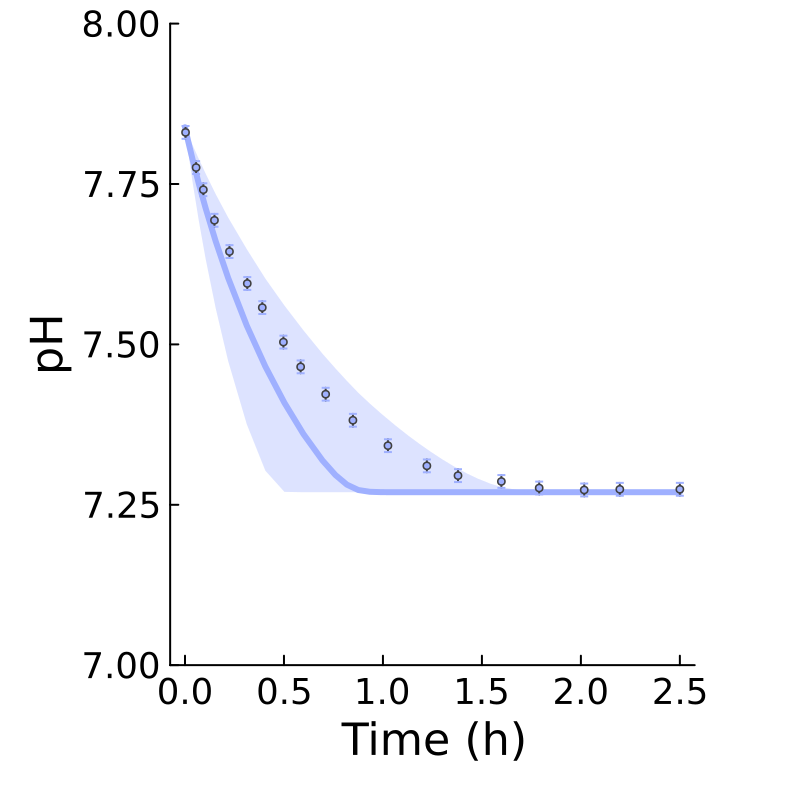

In [93]:
filename = "../data/external/kern_pH.csv"
pHplottingargs = (range = 1, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2, labels = [""])
Kernreactionargs = (BufferperNTP = 0.0, NaperNTP = 3.87,seperateDNA = true, bufferpKa = 7.48)
kernphplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; pHplottingargs..., Kernreactionargs...)
plot!(dpi = 200, ylims = (7.0,8.0), size = (400,400))
savefig(kernphplot,"../figures/arranta530figs/kernph.png")
kernphplot

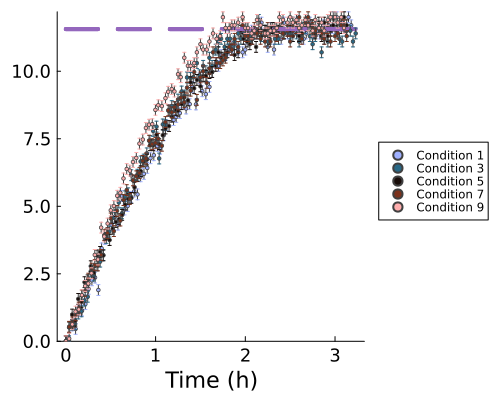

In [94]:
include("../modules/IVTmodel.jl")
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
Arrantareactionargs = (BufferperNTP = 3.4, NaperNTP = 1.05,seperateDNA = true)
RNAplottingargs = (range = [1,3,5,7,9], dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2.0, showpredictions = false)
arrantaplot3 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; RNAplottingargs..., Arrantareactionargs...)

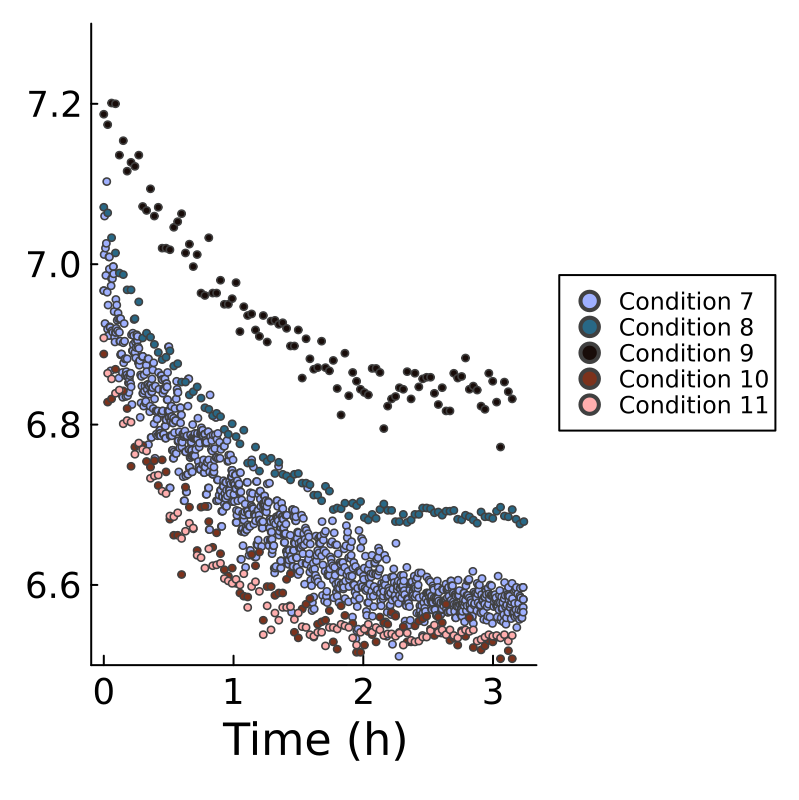

In [95]:
include("../modules/IVTmodel.jl")
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
pHplottingargs = (range = 7:11, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2, showpredictions = false)
arrantaplot3 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))

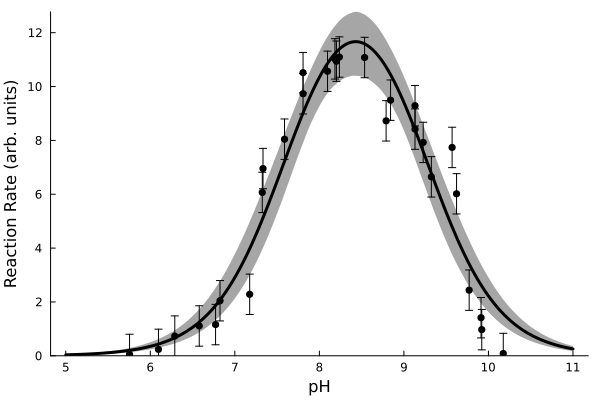

In [97]:
phactivityplot = pHplotting(fittingmodel,osumidata,akamafittedparameterslist,akamafittedcovariancematrix,)
savefig(phactivityplot,"../figures/arranta530figs/phactivity.png")
phactivityplot

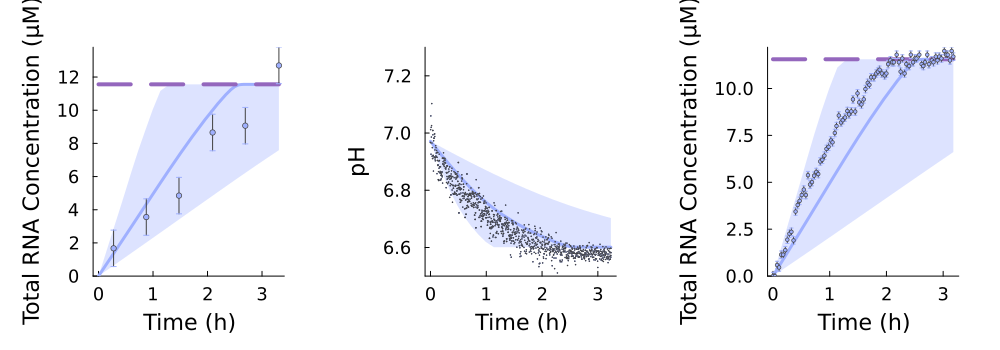

In [41]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
Arrantareactionargs = (BufferperNTP = 3.4, NaperNTP = 0.8,seperateDNA = true)
range = [1]
pHplottingargs = (range = range .+ 6, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 0.5)
ndplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], range = range,dataerrorbars = true, plotsize = (500,400), multiplot = false, Arrantareactionargs...)
phplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
RNAplottingargs = (range = range .*2 .-1, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2.0)
ramanplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], RNAplottingargs..., Arrantareactionargs...)
plot(ndplot,phplot,ramanplot,layout = (1,3), size = (1000,350),bottommargin = 10mm,leftmargin = 10mm,topmargin = 10mm)

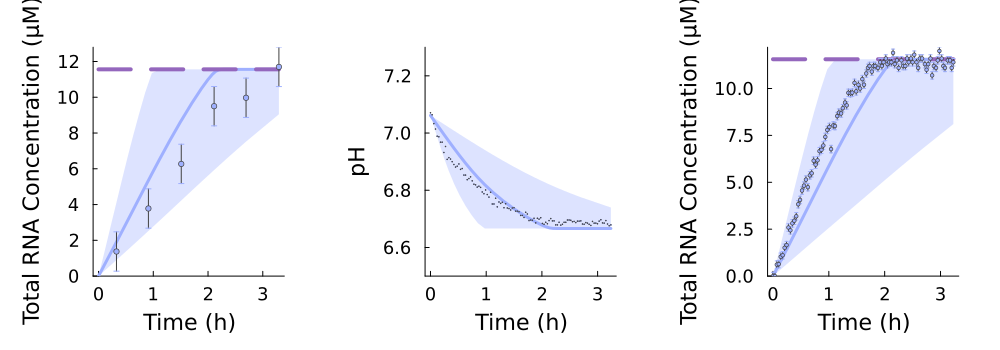

In [42]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
Arrantareactionargs = (BufferperNTP = 3.4, NaperNTP = 0.88,seperateDNA = true)
range = [2]
pHplottingargs = (range = range .+ 6, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 0.5)
ndplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], range = range,dataerrorbars = true, plotsize = (500,400), multiplot = false, Arrantareactionargs...)
phplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
RNAplottingargs = (range = range .*2 .-1, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2.0)
ramanplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], RNAplottingargs..., Arrantareactionargs...)
plot(ndplot,phplot,ramanplot,layout = (1,3), size = (1000,350),bottommargin = 10mm,leftmargin = 10mm,topmargin = 10mm)

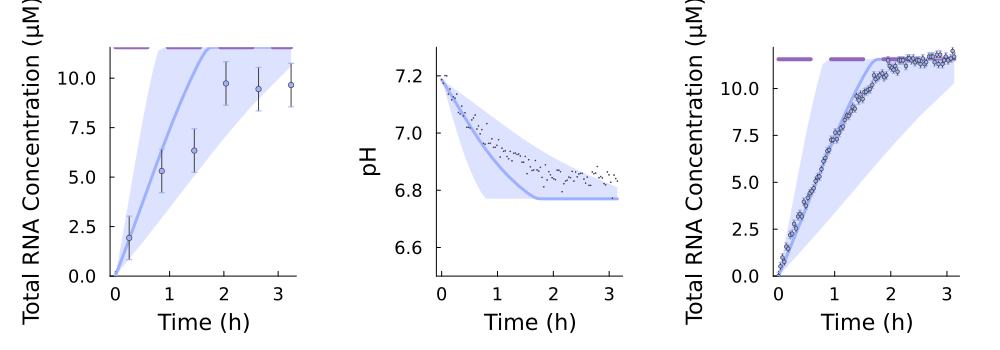

In [43]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
Arrantareactionargs = (BufferperNTP = 3.4, NaperNTP = 1.01,seperateDNA = true)
range = [3]
pHplottingargs = (range = range .+ 6, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 0.5)
ndplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], range = range,dataerrorbars = true, plotsize = (500,400), multiplot = false, Arrantareactionargs...)
phplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
RNAplottingargs = (range = range .*2 .-1, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2.0)
ramanplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], RNAplottingargs..., Arrantareactionargs...)
plot(ndplot,phplot,ramanplot,layout = (1,3), size = (1000,350),bottommargin = 10mm,leftmargin = 10mm,topmargin = 10mm)

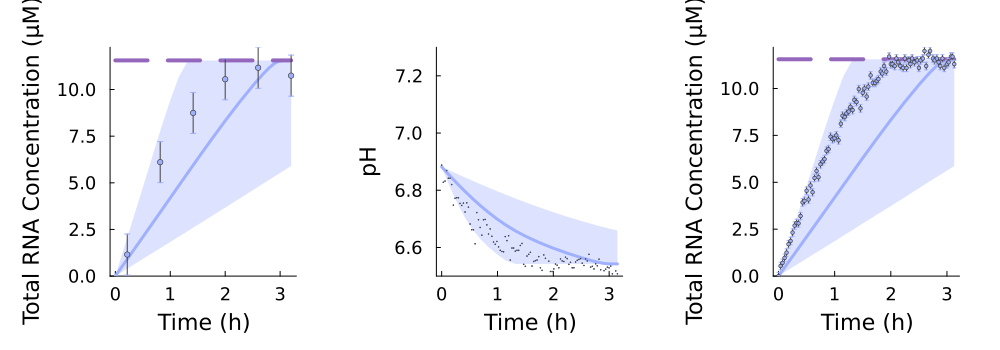

In [46]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
Arrantareactionargs = (BufferperNTP = 3.4, NaperNTP = 0.73,seperateDNA = true)
range = [4]
pHplottingargs = (range = range .+ 6, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 0.5)
ndplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], range = range,dataerrorbars = true, plotsize = (500,400), multiplot = false, Arrantareactionargs...)
phplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
RNAplottingargs = (range = range .*2 .-1, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2.0)
ramanplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], RNAplottingargs..., Arrantareactionargs...)
plot(ndplot,phplot,ramanplot,layout = (1,3), size = (1000,350),bottommargin = 10mm,leftmargin = 10mm,topmargin = 10mm)

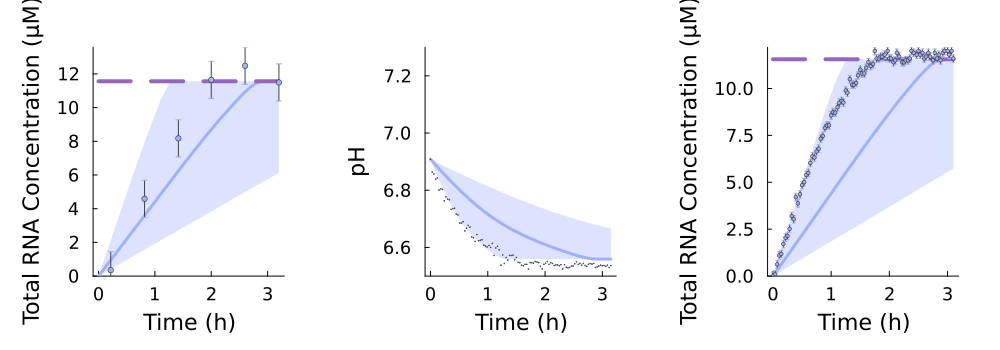

In [49]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
Arrantareactionargs = (BufferperNTP = 3.4, NaperNTP = 0.75,seperateDNA = true)
range = [5]
pHplottingargs = (range = range .+ 6, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 0.5)
ndplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], range = range,dataerrorbars = true, plotsize = (500,400), multiplot = false, Arrantareactionargs...)
phplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
RNAplottingargs = (range = range .*2 .-1, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2.0)
ramanplot = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; labels = [""], RNAplottingargs..., Arrantareactionargs...)
plot(ndplot,phplot,ramanplot,layout = (1,3), size = (1000,350),bottommargin = 10mm,leftmargin = 10mm,topmargin = 10mm)

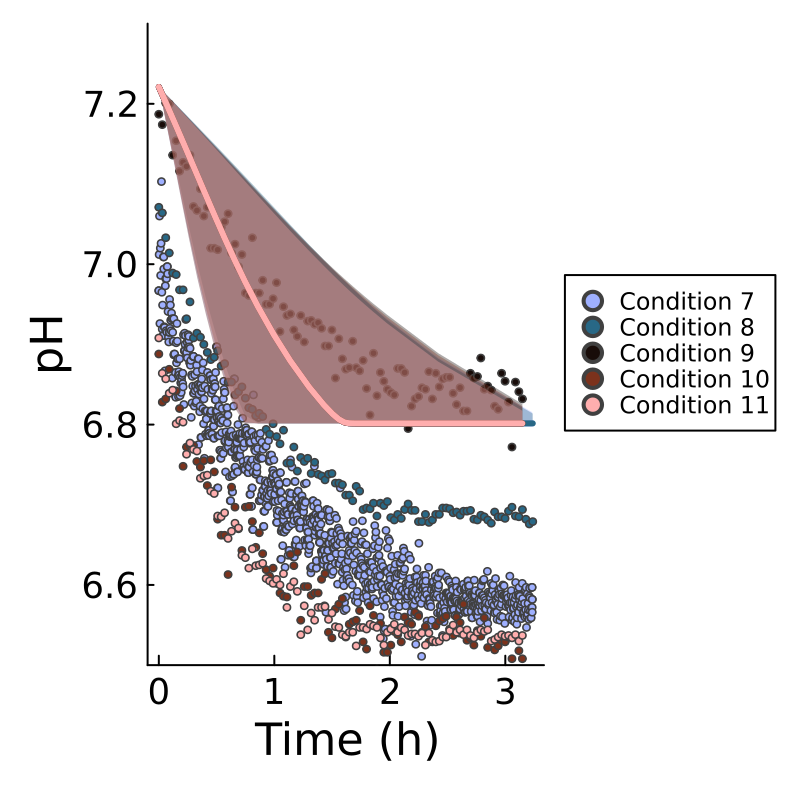

In [98]:
include("../modules/IVTmodel.jl")
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
pHplottingargs = (range = 7:11, dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2)
arrantaplot3 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename; pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.3), size = (400,400))

In [99]:
Flucfilename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA_006.csv"
printresidual(fittingmodel,modeldata,osumidata,akamafittedparameterslist;customfile = true,customfilename = Flucfilename, Arrantareactionargs...)

Total Residual:                        1339.4
Components of residual:
Concentration Trajectories (Figure 2): 318.9
Initial Reaction Rate (Figure 3A):     222.6
Mg2PPi solubility (Figure 3B):         213.2
Parameter priors:                      70.0
Custom Data:                           450.3
pH Effect Data:                        64.3


In [100]:
res = (model,data,x) -> customresidualeval(model,data,osumidata,Flucfilename,x; Arrantareactionargs...)
optim=localopt(fittingmodel, modeldata,300,akamafittedparameterslist,res,verbose = true)
customfittedparamslist = optim[4]
customfittedparams = fullparameterset(fittingmodel,customfittedparamslist)
customcovariancemat = getcovariancematrix(fittingmodel,modeldata,osumidata,customfittedparamslist;customfile = true,customfilename = Flucfilename, Arrantareactionargs...)
writedlm( "../outputs/customfittedparameters.csv",  customfittedparamslist, ',')
writedlm( "../outputs/customcovariancematrix.csv",  customcovariancemat, ',')

1339.5003887597734
107656.47190555405
1379.8026393210214
1093.3580804246703
1087.7016521636403
1092.1506995789086
1085.189083647629
1083.590178809108
1083.1973099902727
1080.2979613727784
1072.0083224552075
1067.3694603148467
1063.0343542018754
1060.897957070891
1060.2756382617592
1059.279533090324
1058.3120109924655
1057.3899784796768
1056.7831790884557
1056.6193868832142
1056.5718746179932
1056.5031090610537
1056.4476910195879
1056.3859562074826
1056.3023885825512
1056.2976818572965
1056.2237274929244
1056.2174929070977
1056.2129317009767
1056.2067490843053
1056.1972265799557
1056.1831208453298
1056.1701442499013
1056.1654001948066
1056.161400363268
1056.1591840060041
1056.156810488043
1056.1530382687847
1056.1479477944026
1056.1414846573198
1056.1338906207056
1056.1311235224643
1056.1310718127284
1056.13107536894
1056.131068687655
got 1056.131068687655 at [17892.510125339497, 223048.46921509565, 494669.8686276593, 0.00025758336008767016, 0.0002726930358762106, 3.841573248343452e-5, 

In [101]:
Flucfilename = "../data/arranta/batchrun_5_1/ramandata.csv"
printresidual(fittingmodel,modeldata,osumidata,customfittedparamslist;customfile = true,customfilename = Flucfilename, Arrantareactionargs...)

Total Residual:                        1214.3
Components of residual:
Concentration Trajectories (Figure 2): 318.2
Initial Reaction Rate (Figure 3A):     239.1
Mg2PPi solubility (Figure 3B):         213.2
Parameter priors:                      72.8
Custom Data:                           300.3
pH Effect Data:                        70.9


In [102]:
log10.(akamafittedparams)

ComponentVector{Float64}(k_dT7 = -Inf, k_i = 4.183164272300746, k_e = 5.318462640002647, k_e_seperateDNA = 5.723582572277547, k_off = 3.635483746814912, k_on = 2.3096301674258988, K_1 = -3.6330615764038554, K_2 = -3.4406258061404342, Ki_PPi = -4.317065365965467, K_a = -7.631494476398028, K_b = -9.227786453294799, k_pH = 1.1870250064472911, gamma = 0.0, theta = -1.6819366650372385, K_ds = 0.0, kPPiase = 0.0, KMPPiase = -3.669586226650809, k_precip = 0.6001626472144765, B = 1.6449817620385045, k_d = 4.697745070202924, K_HNTP = 6.4867, K_HMgNTP = 2.00832, K_HPPi = 9.02, K_HMgPPi = 3.32, K_H2PPi = 6.26, K_H2MgPPi = 2.11, K_MgNTP = 4.0227, K_Mg2NTP = 1.6049, K_MgPPi = 5.1185718424668245, K_Mg2PPi = 3.8656042743628474, Mg2PPi_eq = -3.891671958714386, K_MgPi = 1.6354428, K_HPi = 6.620343, K_NaPi = 0.77, K_NaNTP = 1.16)

In [103]:
log10.(customfittedparams)

ComponentVector{Float64}(k_dT7 = -Inf, k_i = 4.25267127165252, k_e = 5.348399247018486, k_e_seperateDNA = 5.6943154573880825, k_off = 3.635483746814912, k_on = 2.3096301674258988, K_1 = -3.5890821958755774, K_2 = -3.5643259530710316, Ki_PPi = -4.415490881583506, K_a = -7.703306237874095, K_b = -9.176074926561375, k_pH = 1.2107558354934782, gamma = 0.0, theta = -1.6819366650372385, K_ds = 0.0, kPPiase = 0.0, KMPPiase = -3.669586226650809, k_precip = 0.6882329001258553, B = 1.6443649000945881, k_d = 4.702376541635849, K_HNTP = 6.4867, K_HMgNTP = 2.00832, K_HPPi = 9.02, K_HMgPPi = 3.32, K_H2PPi = 6.26, K_H2MgPPi = 2.11, K_MgNTP = 4.0227, K_Mg2NTP = 1.6049, K_MgPPi = 5.133510356472327, K_Mg2PPi = 3.8874074821383946, Mg2PPi_eq = -3.8797310170387265, K_MgPi = 1.6354428, K_HPi = 6.620343, K_NaPi = 0.77, K_NaNTP = 1.16)

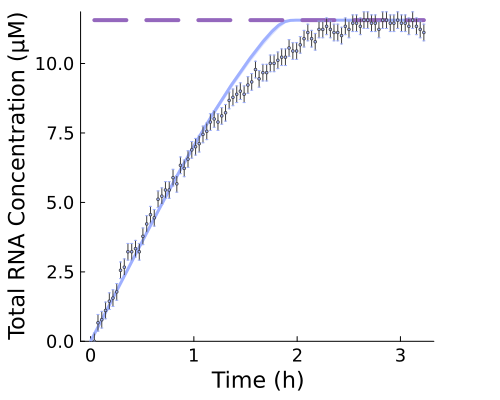

In [104]:
filename = "../data/arranta/batchrun_5_1/ramandata.csv"
RNAplottingargs = (labels = [""], range = [1],dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 1.5)
arrantaplot3 = plotfromcsv(fittingmodel,customfittedparamslist,customcovariancemat,filename; RNAplottingargs..., Arrantareactionargs...)

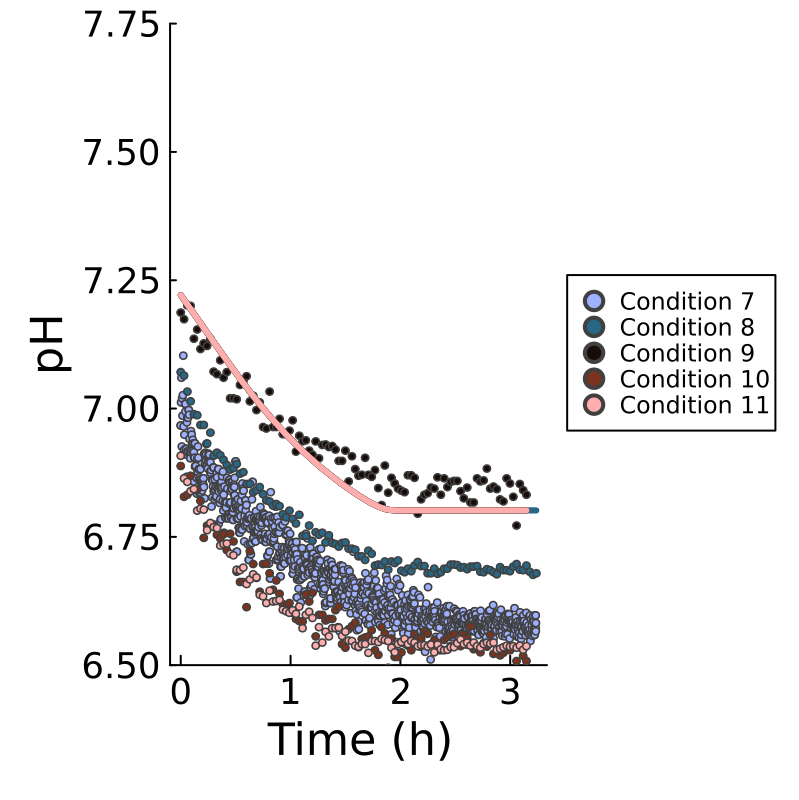

In [105]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
arrantaplot3 = plotfromcsv(fittingmodel,customfittedparamslist,customcovariancemat,filename; pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.75), size = (400,400))

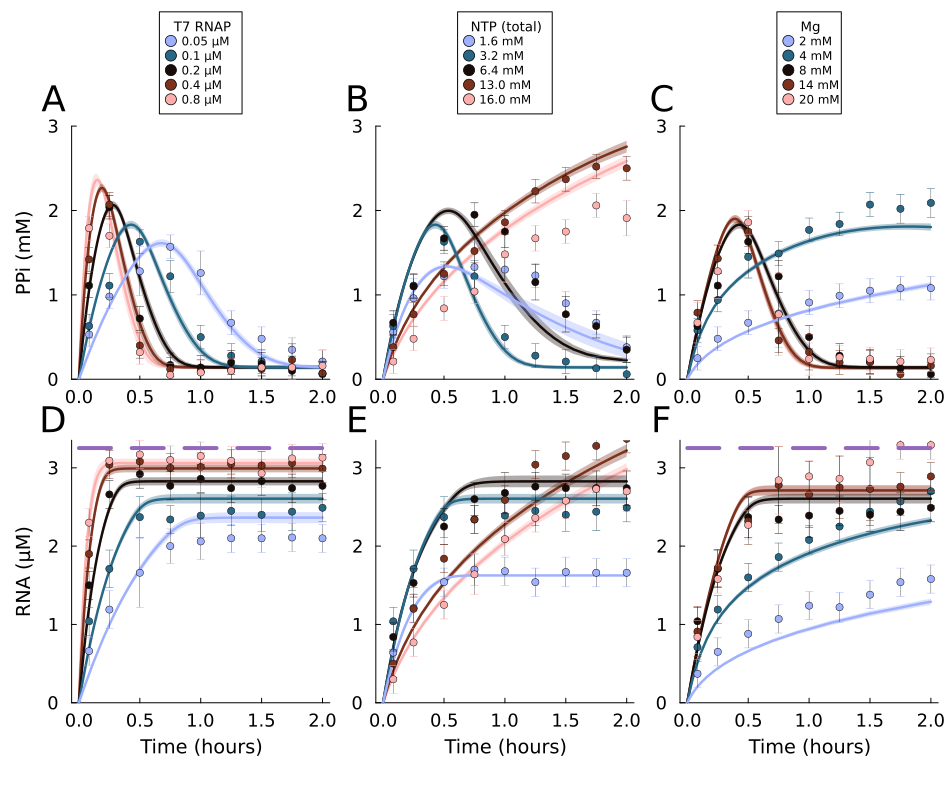

In [293]:
plt = revision1plot1(fittingmodel,modeldata,customfittedparams, customcovariancemat, true,true)

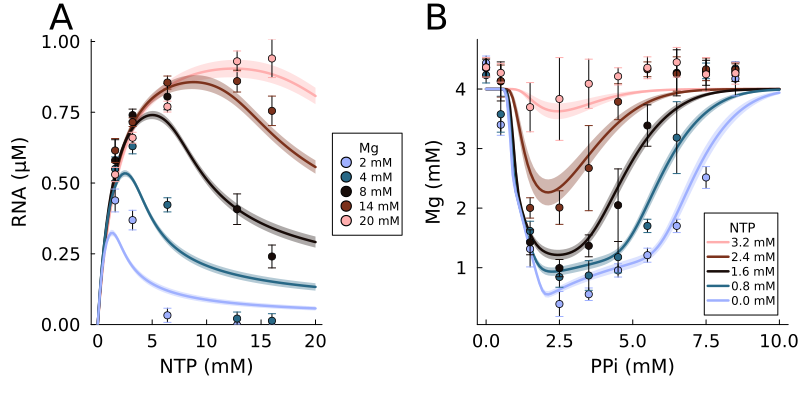

In [294]:
plt = revision1plot2(fittingmodel,modeldata, customfittedparams, customcovariancemat, true,true)

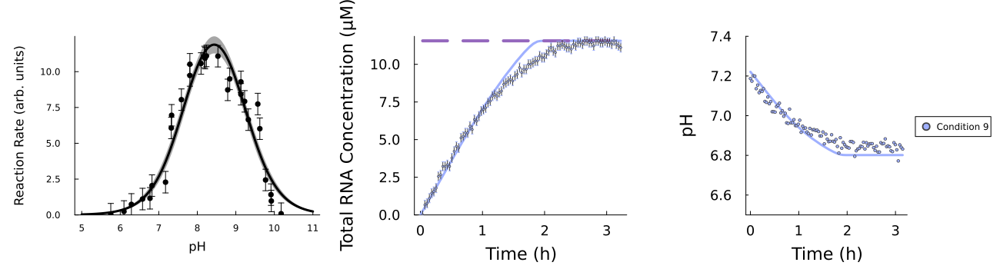

In [110]:
filename = "../data/arranta/batchrun_5_1/ramandata.csv"
plt2 = plotfromcsv(fittingmodel,customfittedparamslist,customcovariancemat,filename; RNAplottingargs..., Arrantareactionargs...)

filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
pHplottingargs = (range = [9], dataerrorbars = true, plotsize = (500,400), multiplot = false, markersize = 2)
plt1 = plotfromcsv(fittingmodel,customfittedparamslist,customcovariancemat,filename; pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.4), size = (400,400))

plt3 = pHplotting(fittingmodel, osumidata, customfittedparamslist, customcovariancemat)

masterplot = plot(plt3,plt2,plt1, layout = (1,3), size = (1300,350),bottommargin = 10mm, leftmargin = 10mm, topmargin = 10mm)
savefig(masterplot,"../figures/arranta530figs/masterplot.png")
masterplot

In [112]:
#TODO fix this
function discreteIVT(t)
    time = [0.03666666666666667, 0.07166666666666666, 0.10833333333333334, 0.145, 0.18166666666666667, 0.21666666666666667, 0.2533333333333333, 0.29, 0.32666666666666666, 0.36166666666666664, 0.3983333333333333, 0.435, 0.4716666666666667, 0.5066666666666666, 0.5433333333333333, 0.58, 0.6166666666666667, 0.6533333333333333, 0.69, 0.725, 0.7616666666666667, 0.7983333333333333, 0.835, 0.87, 0.9066666666666666, 0.9433333333333334, 0.98, 1.0166666666666666, 1.0516666666666667, 1.0883333333333334, 1.125, 1.16, 1.1966666666666665, 1.2333333333333334, 1.27, 1.3066666666666666, 1.3416666666666666, 1.3783333333333334, 1.415, 1.45, 1.4866666666666668, 1.5233333333333334, 1.5599999999999998, 1.5966666666666667, 1.6316666666666668, 1.6683333333333332, 1.7049999999999998, 1.74, 1.7766666666666666, 1.8133333333333332, 1.8499999999999999, 1.8866666666666667, 1.9216666666666666, 1.9583333333333333, 1.995, 2.03, 2.0666666666666664, 2.1033333333333335, 2.14, 2.175, 2.2116666666666664, 2.2483333333333335, 2.2849999999999997, 2.3216666666666668, 2.356666666666667, 2.393333333333333, 2.43, 2.466666666666667, 2.5016666666666665, 2.5383333333333336, 2.575, 2.6116666666666664, 2.646666666666667, 2.683333333333333, 2.7199999999999998, 2.756666666666667, 2.7916666666666665, 2.828333333333333, 2.865, 2.9016666666666664, 2.9366666666666665, 2.9733333333333336, 3.01, 3.046666666666667, 3.0816666666666666, 3.118333333333333, 3.1550000000000002, 3.1916666666666664, 3.2266666666666666]
    RNA = [0.0, 0.517, 0.99, 0.76, 1.57, 1.46, 2.19, 2.26, 2.78, 2.54, 3.18, 3.31, 3.18, 3.96, 3.75, 4.17, 4.42, 4.52, 4.68, 5.06, 5.27, 5.31, 5.7, 6.12, 6.3, 6.66, 6.73, 7.26, 7.26, 7.65, 7.3, 7.63, 7.88, 7.97, 8.32, 8.57, 8.54, 8.78, 9.03, 8.92, 9.59, 9.37, 9.68, 9.44, 9.81, 9.83, 9.93, 9.97, 10.2, 10.7, 10.5, 10.6, 10.7, 10.8, 10.6, 10.7, 11.5, 11.2, 11.1, 11.0, 11.2, 10.9, 11.5, 11.5, 11.5, 11.2, 11.6, 11.6, 11.5, 11.6, 11.4, 11.5, 11.5, 11.3, 11.6, 11.3, 11.4, 11.7, 11.7, 11.7, 11.4, 11.8, 11.3, 11.8, 11.3, 11.5, 11.7, 11.5, 11.6]
    ATP = [8.0, 7.7544508670520225, 7.693063583815029, 7.447514450867052, 6.772254335260116, 6.956416184971098, 6.710867052023121, 6.772254335260116, 6.649479768786128, 6.281156069364162, 5.790057803468208, 6.096994219653179, 6.342543352601155, 5.912832369942197, 5.851445086705202, 5.360346820809248, 5.544508670520231, 5.176184971098266, 5.176184971098266, 5.176184971098266, 4.8078612716763, 4.685086705202313, 4.7464739884393055, 4.3781502890173405, 4.500924855491329, 4.439537572254335, 4.685086705202313, 4.132601156069364, 4.316763005780347, 4.316763005780347, 4.0098265895953755, 3.9484393063583814, 4.193988439306358, 3.887052023121387, 4.255375722543352, 3.580115606936416, 3.518728323699422, 3.334566473988439, 3.518728323699422, 3.1504046242774564, 3.518728323699422, 3.580115606936416, 3.2117919075144505, 3.027630057803468, 3.2731791907514447, 3.089017341040462, 2.843468208092485, 2.720693641618497, 2.47514450867052, 2.536531791907514, 2.782080924855491, 2.782080924855491, 2.536531791907514, 2.536531791907514, 2.47514450867052, 2.843468208092485, 2.2909826589595372, 2.3523699421965314, 2.4137572254335256, 2.6593063583815026, 2.229595375722543, 2.2909826589595372, 2.229595375722543, 2.168208092485549, 2.168208092485549, 2.1068208092485547, 2.229595375722543, 1.9840462427745662, 2.2909826589595372, 2.04543352601156, 2.4137572254335256, 2.168208092485549, 2.47514450867052, 2.4137572254335256, 1.8612716763005777, 2.229595375722543, 2.2909826589595372, 2.536531791907514, 1.9840462427745662, 2.229595375722543, 2.1068208092485547, 2.229595375722543, 2.04543352601156, 1.7384971098265891, 2.229595375722543, 2.3523699421965314, 2.3523699421965314, 2.3523699421965314, 1.8612716763005777]
    UTP = [8.0, 7.785664739884393, 7.714219653179191, 7.571329479768786, 7.642774566473989, 7.535606936416185, 7.571329479768786, 7.249826589595376, 7.178381502890174, 7.178381502890174, 7.178381502890174, 6.8926011560693645, 6.785433526011561, 6.928323699421965, 6.713988439306359, 6.856878612716763, 6.642543352601156, 6.4996531791907515, 6.4996531791907515, 6.213872832369942, 6.285317919075144, 6.213872832369942, 6.0352601156069365, 6.178150289017341, 5.963815028901734, 5.820924855491329, 5.892369942196532, 5.678034682080924, 5.713757225433525, 5.713757225433525, 5.678034682080924, 5.570867052023122, 5.427976878612717, 5.678034682080924, 5.463699421965318, 5.320809248554913, 5.1779190751445086, 5.285086705202312, 5.070751445086705, 5.1779190751445086, 5.070751445086705, 5.1779190751445086, 5.070751445086705, 5.106473988439307, 5.070751445086705, 4.9278612716763, 4.963583815028902, 4.7849710982658955, 4.9278612716763, 4.749248554913295, 4.749248554913295, 4.677803468208093, 4.570635838150289, 4.677803468208093, 4.713526011560694, 4.7849710982658955, 4.642080924855491, 4.642080924855491, 4.60635838150289, 4.392023121387283, 4.463468208092485, 4.570635838150289, 4.499190751445086, 4.28485549132948, 4.534913294797688, 4.392023121387283, 4.427745664739884, 4.356300578034682, 4.28485549132948, 4.463468208092485, 4.213410404624278, 4.356300578034682, 4.642080924855491, 4.427745664739884, 4.392023121387283, 4.642080924855491, 4.463468208092485, 4.499190751445086, 4.28485549132948, 4.320578034682081, 4.427745664739884, 4.499190751445086, 4.427745664739884, 4.463468208092485, 4.356300578034682, 4.534913294797688, 4.427745664739884, 4.463468208092485, 4.427745664739884]
    CTP = [8.0, 7.84, 7.6, 6.96, 6.72, 6.16, 6.24, 6.48, 5.76, 5.76, 5.28, 5.6, 4.88, 4.88, 5.28, 4.8, 4.0, 3.68, 3.76, 3.6, 4.16, 3.92, 3.36, 4.0, 2.88, 2.8, 2.48, 2.4, 3.36, 1.92, 3.04, 2.24, 2.24, 2.0, 1.92, 2.32, 1.84, 1.52, 1.92, 1.6, 0.96, 1.52, 0.96, 1.52, 1.04, 1.04, 0.32, 0.8, 0.8, 0.64, 0.72, 0.4, 0.64, 0.32, 0.16, 0.4, -0.08, 0.0, -0.08, 0.0, 0.16, 0.16, -0.32, 0.0, -0.48, -0.24, 0.16, -0.32, -0.4, -0.08, -0.24, -0.4, -0.8, -0.32, -0.48, 0.0, 0.24, -0.32, -0.8, 0.16, 0.0, -0.32, -0.24, 0.08, -0.16, -0.24, -0.32, 0.0, 0.0]
    GTP = [8.0, 7.184277456647399, 6.368554913294798, 6.368554913294798, 5.824739884393064, 4.601156069364162, 4.941040462427746, 5.756763005780347, 5.552832369942196, 4.261271676300579, 5.960693641618497, 5.960693641618497, 5.076994219653178, 5.620809248554914, 5.280924855491329, 4.601156069364162, 4.3292485549132955, 4.261271676300579, 5.212947976878612, 4.601156069364162, 4.3292485549132955, 3.17364161849711, 3.3095953757225436, 4.193294797687861, 3.989364161849711, 3.2416184971098265, 3.1056647398843937, 4.057341040462427, 2.4938728323699424, 3.717456647398844, 2.018034682080925, 2.221965317919075, 2.6298265895953756, 2.561849710982659, 2.018034682080925, 2.8337572254335264, 0.8624277456647402, 1.8141040462427749, 1.6781502890173414, 1.4062427745664743, 1.6101734104046246, 3.37757225433526, 1.5421965317919077, 1.202312138728324, 0.7264739884393066, 1.746127167630058, 0.930404624277457, 0.45456647398843963, 1.6101734104046246, -0.22520231213872788, 0.5225433526011564, 0.2506358381502892, 1.9500578034682083, 0.2506358381502892, 0.5225433526011564, 0.31861271676300607, 1.5421965317919077, 0.6584971098265899, 0.8624277456647402, 0.8624277456647402, 0.6584971098265899, 0.31861271676300607, -0.02127167630057758, -0.7010404624277455, 0.7264739884393066, 0.45456647398843963, 0.04670520231213904, -0.02127167630057758, 1.4062427745664743, 0.8624277456647402, 0.5225433526011564, -0.2931791907514447, 0.2506358381502892, 1.0663583815028905, 0.6584971098265899, -0.497109826589595, 0.930404624277457, 1.0663583815028905, 0.2506358381502892, 0.11468208092485588, -0.6330635838150287, -0.7010404624277455, 1.0663583815028905, 0.5225433526011564, 0.8624277456647402, -0.22520231213872788, 0.5225433526011564, 0.9983815028901737, 1.202312138728324]
    GTP = [8.0, 7.184277456647399, 6.368554913294798, 6.368554913294798, 5.824739884393064, 4.601156069364162, 4.941040462427746, 5.756763005780347, 5.552832369942196, 4.261271676300579, 5.960693641618497, 5.960693641618497, 5.076994219653178, 5.620809248554914, 5.280924855491329, 4.601156069364162, 4.3292485549132955, 4.261271676300579, 5.212947976878612, 4.601156069364162, 4.3292485549132955, 3.17364161849711, 3.3095953757225436, 4.193294797687861, 3.989364161849711, 3.2416184971098265, 3.1056647398843937, 4.057341040462427, 2.4938728323699424, 3.717456647398844, 2.018034682080925, 2.221965317919075, 2.6298265895953756, 2.561849710982659, 2.018034682080925, 2.8337572254335264, 0.8624277456647402, 1.8141040462427749, 1.6781502890173414, 1.4062427745664743, 1.6101734104046246, 3.37757225433526, 1.5421965317919077, 1.202312138728324, 0.7264739884393066, 1.746127167630058, 0.930404624277457, 0.45456647398843963, 1.6101734104046246, -0.22520231213872788, 0.5225433526011564, 0.2506358381502892, 1.9500578034682083, 0.2506358381502892, 0.5225433526011564, 0.31861271676300607, 1.5421965317919077, 0.6584971098265899, 0.8624277456647402, 0.8624277456647402, 0.6584971098265899, 0.31861271676300607, -0.02127167630057758, -0.7010404624277455, 0.7264739884393066, 0.45456647398843963, 0.04670520231213904, -0.02127167630057758, 1.4062427745664743, 0.8624277456647402, 0.5225433526011564, -0.2931791907514447, 0.2506358381502892, 1.0663583815028905, 0.6584971098265899, -0.497109826589595, 0.930404624277457, 1.0663583815028905, 0.2506358381502892, 0.11468208092485588, -0.6330635838150287, -0.7010404624277455, 1.0663583815028905, 0.5225433526011564, 0.8624277456647402, -0.22520231213872788, 0.5225433526011564, 0.9983815028901737, 1.202312138728324]
    pHtimes = [0.0, 0.029978889, 0.059957778, 0.089936666, 0.119915555, 0.149894444, 0.179873333, 0.209852222, 0.239831111, 0.26981, 0.299788889, 0.329767778, 0.359746667, 0.389725556, 0.419704444, 0.449683333, 0.479662222, 0.509641111, 0.53962, 0.569598889, 0.599577778, 0.629556667, 0.659535556, 0.689514444, 0.719493333, 0.749472222, 0.779451111, 0.80943, 0.839408889, 0.869387778, 0.899366667, 0.929345555, 0.959324444, 0.989303333, 1.019282222, 1.049261111, 1.07924, 1.109218889, 1.139197778, 1.169176667, 1.199155555, 1.229134444, 1.259113333, 1.289092222, 1.319071111, 1.34905, 1.379028889, 1.409007778, 1.438986667, 1.468965555, 1.498944444, 1.528923333, 1.558902222, 1.588881111, 1.61886, 1.648838889, 1.678817778, 1.708796667, 1.738775555, 1.768754444, 1.798733333, 1.828712222, 1.858691111, 1.88867, 1.918648889, 1.948627778, 1.978606667, 2.008585555, 2.038564444, 2.068543333, 2.098522222, 2.128501111, 2.15848, 2.188458889, 2.218437778, 2.248416667, 2.278395555, 2.308374444, 2.338353333, 2.368332222, 2.398311111, 2.42829, 2.458268889, 2.488247778, 2.518226666, 2.548205555, 2.578184444, 2.608163333, 2.638142222, 2.668121111, 2.6981, 2.728078889, 2.758057778, 2.788036666, 2.818015555, 2.847994444, 2.877973333, 2.907952222, 2.937931111, 2.96791, 2.997888889, 3.027867778, 3.057846666, 3.087825555, 3.117804444, 3.647783333]
    pH = [7.187, 7.174, 7.201, 7.2, 7.136, 7.154, 7.116, 7.127, 7.122, 7.136, 7.072, 7.067, 7.094, 7.06, 7.071, 7.02, 7.02, 7.018, 7.046, 7.053, 7.063, 7.014, 7.025, 6.997, 7.012, 6.964, 6.961, 7.033, 6.964, 6.964, 6.98, 6.95, 6.95, 6.957, 6.9769998, 6.916, 6.947, 6.936, 6.938, 6.918, 6.91, 6.936, 6.903, 6.929, 6.93, 6.925, 6.927, 6.92, 6.898, 6.898, 6.918, 6.858, 6.907, 6.882, 6.869, 6.871, 6.904, 6.871, 6.867, 6.88, 6.845, 6.812, 6.889, 6.836, 6.865, 6.854, 6.844, 6.84, 6.837, 6.87, 6.87, 6.865, 6.795, 6.823, 6.832, 6.835, 6.846, 6.844, 6.866, 6.832, 6.864, 6.847, 6.857, 6.859, 6.859, 6.839, 6.825, 6.846, 6.817, 6.817, 6.864, 6.858, 6.86, 6.883, 6.844, 6.848, 6.843, 6.823, 6.819, 6.864, 6.854, 6.828, 6.772, 6.853, 6.841, 6.832]
    IVTdata = hcat(RNA,ATP,UTP,CTP,GTP)
    return [IVTdata[sum(time .< t)+1,:]...,pH[sum(pHtimes .< t)+1]]
end

discreteIVT (generic function with 1 method)

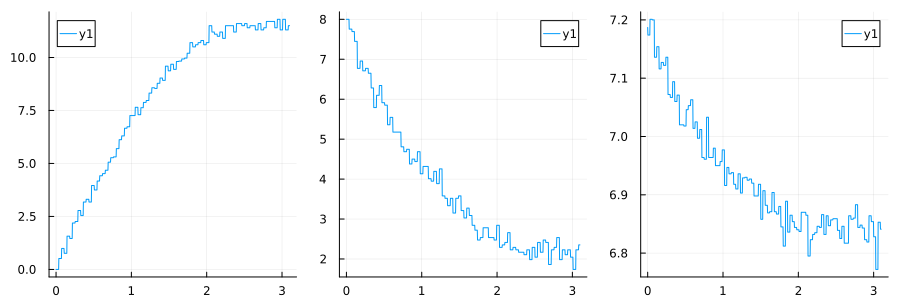

In [118]:
ts = LinRange(0,3.1,1000)
RNAvalues = [discreteIVT(t)[1] for t in ts]
ATPvalues = [discreteIVT(t)[2] for t in ts]
pHvalues = [discreteIVT(t)[end] for t in ts]

plt1 = plot(ts,RNAvalues)
plt2 = plot(ts,ATPvalues)
plt3 = plot(ts,pHvalues)
plot(plt1,plt2,plt3,layout = (1,3), size = (900,300))

In [119]:
include("../modules/IVTmodel.jl")
L1 = 8e-4
alpha = 10
L2 = 0.0
N_all = 2117

plt1 = plot(label = "Sensor Data",ylabel = "Total RNA (μM)",xlabel = "Time (h)",legend = :outerbottom)
plt2 = plot(label = "",legend = :outerbottom,ylabel = "ATP (mM)",xlabel = "Time (h)")
plt3 = plot(label = "",legend = :outerbottom,ylabel = "pH",xlabel = "Time (h)")

inputs = (T7RNAP = 240e-9, ATP = 8e-3,UTP = 8e-3,CTP = 8e-3,GTP = 8e-3, Mg = 26e-3, Buffer = 0.040, DNA = 19.442, final_time = 3.2)
PPiase = 0.2
Cap = 4e-3
stoich = (531,309,692,588)
concentrationargs = (PPiase = 0.2,Cap = 4e-3,stoich = (531,309,692,588))

sol = runobservedbatch(customfittedparams, inputs,[0.0,0.0,0.0,0.0],discreteIVT; concentrationargs..., Arrantareactionargs...)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - No observer")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - No observer")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - No observer")

sol = runobservedbatch(customfittedparams, inputs,[0.1*alpha*L1/1000,0.0,0.1*L2,0.1*L1],discreteIVT; concentrationargs..., Arrantareactionargs...)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - Weak tuning")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - Weak tuning")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - Weak tuning")

sol = runobservedbatch(customfittedparams, inputs,[alpha*L1/1000,0.0,L2,L1],discreteIVT; concentrationargs..., Arrantareactionargs...)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - Moderate tuning")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - Moderate tuning")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - Moderate tuning")

sol = runobservedbatch(customfittedparams, inputs,[alpha*L1/1000,0.0,L2,L1],discreteIVT; concentrationargs..., Arrantareactionargs...)
plot!(plt1,sol[2].t,totalrna(sol,0),linewidth = 3, label = "Model - Strong tuning")
plot!(plt2,sol[2].t,atp(sol,0),linewidth = 3, label = "Model - Strong tuning")
plot!(plt3,sol[2].t,ph(sol,0),linewidth = 3, label = "Model - Strong tuning")

scatter!(plt1,ts,RNAvalues,markersize = 0.2, label = "Process Data")
scatter!(plt2,ts,ATPvalues,markersize = 0.2, label = "Process Data")
scatter!(plt3,ts,pHvalues,markersize = 0.2, label = "Process Data")

fullplot = plot(plt1,plt2,plt3,bottommargin = 5mm,leftmargin = 5mm,dpi = 2000,size = (900,400),layout = (1,3))
plot!(dpi = 2000)
savefig(fullplot,"../figures/arranta530figs/tuning4.png")
fullplot

In [133]:
#First, we are going to generate a new modeling framework where we fix the fitted akama parameters, and only allow two to vary for fitting: k_e
Flucfittingparameters = [Parameter("k_e",5.3e5,1e3,15e5)]
Flucfittingmodel = fixparameters(fittingmodel,akamafittedparameterslist,resetparameters = Flucfittingparameters)
Flucfilename = "../data/arranta/batchrun_5_1/ramandata.csv"
printresidual(model, akamadata, pHdata, x; customfile = false, customfilename = "", reactionkwargs...)
Flucresidualfunction = (model,_,x) -> customresidual(model, Flucfilename,x;Arrantareactionargs...)
optim=localopt(Flucfittingmodel,[],300,log10.([2.3e5]),Flucresidualfunction,verbose = true)
Flucfittedparamslist = optim[4]
Flucfittedparams = fullparameterset(Flucfittingmodel,Flucfittedparamslist)
Fluccovariancemat = getcovariancematrix(Flucfittingmodel,[],[],Flucfittedparamslist;customfile = true,customfilename = Flucfilename, includeakama = false, Arrantareactionargs...);

75883.66453533995
73440.25715570862
50103.11366838622
206984.4196803884
6108.495450066026
398291.0384844894
3545.955426902201
2370.973735106911
2276.352230602013
2275.020807444496
2275.0192356413804
2275.0192358476484
2275.0192356455514
2275.0192356412726
got 2275.0192356412726 at [440131.6547149247] after 14 iterations (returned FTOL_REACHED)


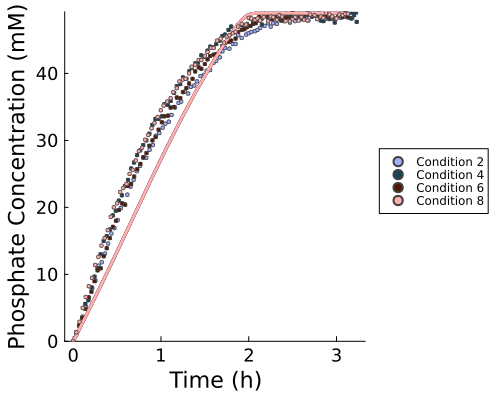

In [134]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_raman_RNA.csv"
arrantaplot3 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename; RNAplottingargs..., Arrantareactionargs...)

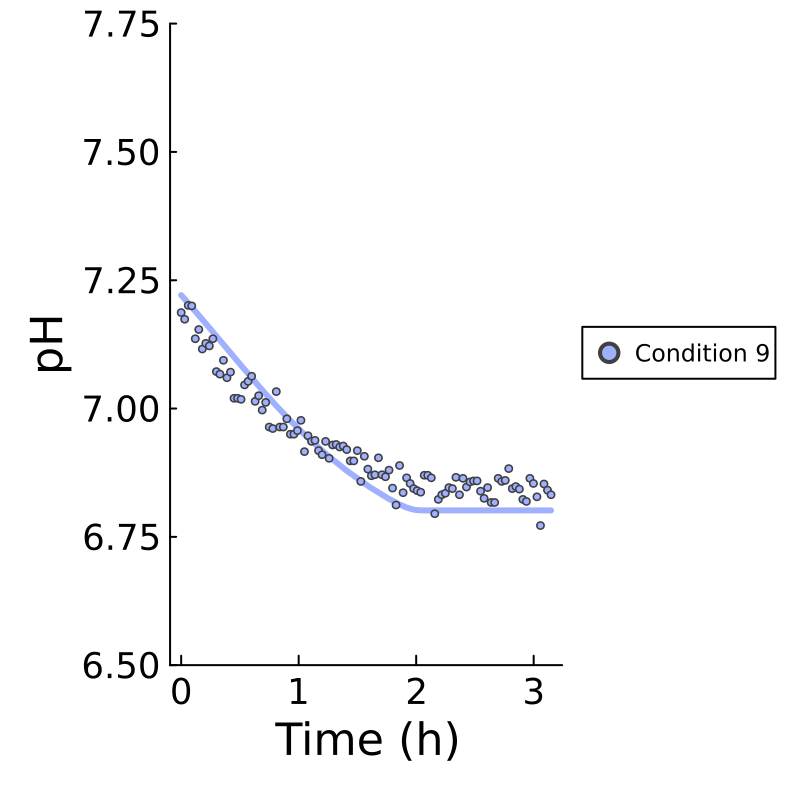

In [135]:
filename = "../data/arranta/batch_COVID_Fluc/arranta_COVID_Fluc_nd_pH.csv"
arrantaplot3 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename; pHplottingargs..., Arrantareactionargs...)
plot!(dpi = 200, ylims = (6.5,7.75), size = (400,400))

In [130]:
dimensionlesspHfactor(Flucfittedparams,10^(-7.25))/dimensionlesspHfactor(Flucfittedparams,10^(-6.80))

2.2854940626011437

In [131]:
dimensionlesspHfactor(Flucfittedparams,10^(-6.80))

0.12641650442783703

In [ ]:
filename = "../data/arranta/arrantaFluc.csv"
arrantaplot1 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, labels = ["Process Devlopment Data"], range = 27:27,dataerrorbars = true, plotsize = (500,400), multiplot = false)
savefig(arrantaplot1,"../figures/FLucPDdata.png")
arrantaplot1

In [ ]:
include("../modules/IVTmodel.jl")
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot3 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, labels = [""], range = [11],dataerrorbars = true, plotsize = (500,400), multiplot = false,markersize = 0.5)
plot!(dpi = 200, ylims = (6.5,7.5), size = (400,400))
savefig(arrantaplot3,"../figures/FLucProcessPh.png")
arrantaplot3

In [ ]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
labels = ["At-Line Raman", "Offline Nanodrop"]
arrantaplot2 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, labels = labels, range = 5:6,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 200)
savefig(arrantaplot2,"../figures/FLucProcessData.png")
arrantaplot2

In [ ]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot2 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, range = 1:4,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 200)
savefig(arrantaplot2,"../figures/FLucProcessData.png")
arrantaplot2

In [ ]:
filename = "../data/arranta/batchrun_5_1/nanodropdata.csv"
arrantaplot2 = plotfromcsv(fittingmodel,akamafittedparameterslist,akamafittedcovariancematrix,filename, range = 1:1,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 200)
savefig(arrantaplot2,"../figures/FLucProcessData.png")
arrantaplot2

In [ ]:
#First, we are going to generate a new modeling framework where we fix the fitted akama parameters, and only allow two to vary for fitting: k_e
Flucfittingparameters = [Parameter("k_e",5.3e5,1e3,15e5)]
Flucfittingmodel = fixparameters(fittingmodel,akamafittedparameterslist,resetparameters = Flucfittingparameters)
Flucfilename = "../data/arranta/batchrun_5_1/ramandata.csv"
Flucresidualfunction = (model,_,x) -> customresidual(model, Flucfilename,x)
optim=localopt(Flucfittingmodel,[],300,log10.([2.3e5]),Flucresidualfunction,verbose = true)
Flucfittedparamslist = optim[4]
Flucfittedparams = fullparameterset(Flucfittingmodel,Flucfittedparamslist)
Fluccovariancemat = getcovariancematrix(Flucfittingmodel,[],Flucfittedparamslist,customfile = true,customfilename = Flucfilename, includeakama = false);

In [ ]:
filename = "../data/arranta/batchrun_5_1/nanodropdata.csv"
arrantaplot2 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename, range = 1:1,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 200)
savefig(arrantaplot2,"../figures/FLucProcessData.png")
arrantaplot2

In [ ]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot2 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename, range = 1:4,dataerrorbars = true, plotsize = (500,400), multiplot = false)
plot!(dpi = 200)
savefig(arrantaplot2,"../figures/FLucProcessData.png")
arrantaplot2

In [ ]:
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot3 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename, labels = [""], range = [7],dataerrorbars = true, plotsize = (500,400), multiplot = false,markersize = 0.5)
plot!(dpi = 200, ylims = (6.5,7.75), size = (400,400))
savefig(arrantaplot3,"../figures/FLucProcessPh.png")
arrantaplot3

In [ ]:
include("../modules/IVTmodel.jl")
filename = "../data/arranta/batchrun_5_1/arrantaCOVID_batch_5_1.csv"
arrantaplot3 = plotfromcsv(Flucfittingmodel,Flucfittedparamslist,Fluccovariancemat,filename, labels = [""], range = [11],dataerrorbars = true, plotsize = (500,400), multiplot = false,markersize = 0.5)
plot!(dpi = 200, ylims = (6.0,7.5), size = (400,400))
savefig(arrantaplot3,"../figures/FLucProcessPh.png")
arrantaplot3